# Import lib

In [7]:
import torch
import torchvision
import os
import json
import numpy as np
import mmcv
import mmdet
import matplotlib.pyplot as plt

from os.path import join
from os import listdir
from PIL import Image, ImageDraw
from random import sample
from mmdet.apis import inference_detector, init_detector, show_result_pyplot
from mmcv import Config
from mmdet.apis import set_random_seed
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from data.dataset import DeepFashion2
from configs.config_ssd300 import cfg

In [4]:
DEVICE = torch.device('cuda')

DEMO_PATH = 'demo'
CHECKPOINT_PATH = 'checkpoints/ssd300_coco_20210803_015428-d231a06e.pth'
CONFING_PATH = 'mmdetection/configs/ssd/ssd300_coco.py'

# See model

Download ssd300 weights

In [3]:
! python download_weights.py --weights ssd300_coco

Founds weights: https://download.openmmlab.com/mmdetection/v2.0/ssd/ssd300_coco/ssd300_coco_20210803_015428-d231a06e.pth

File already present


Init model

In [4]:
model_ssd300 = init_detector(CONFING_PATH, CHECKPOINT_PATH, device=DEVICE)

load checkpoint from local path: checkpoints/ssd300_coco_20210803_015428-d231a06e.pth


Let's see how model see demo images

/home/danil/projects/fashion_detection/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


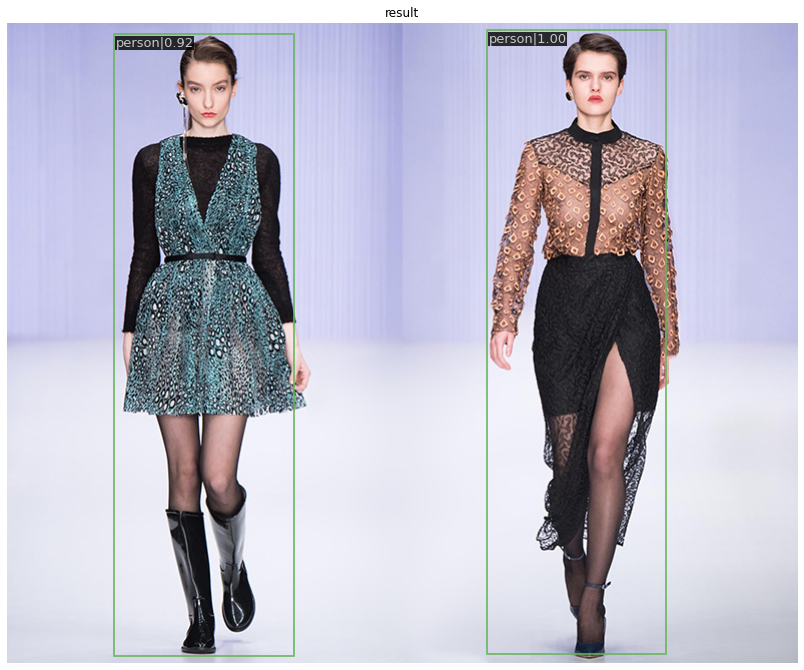

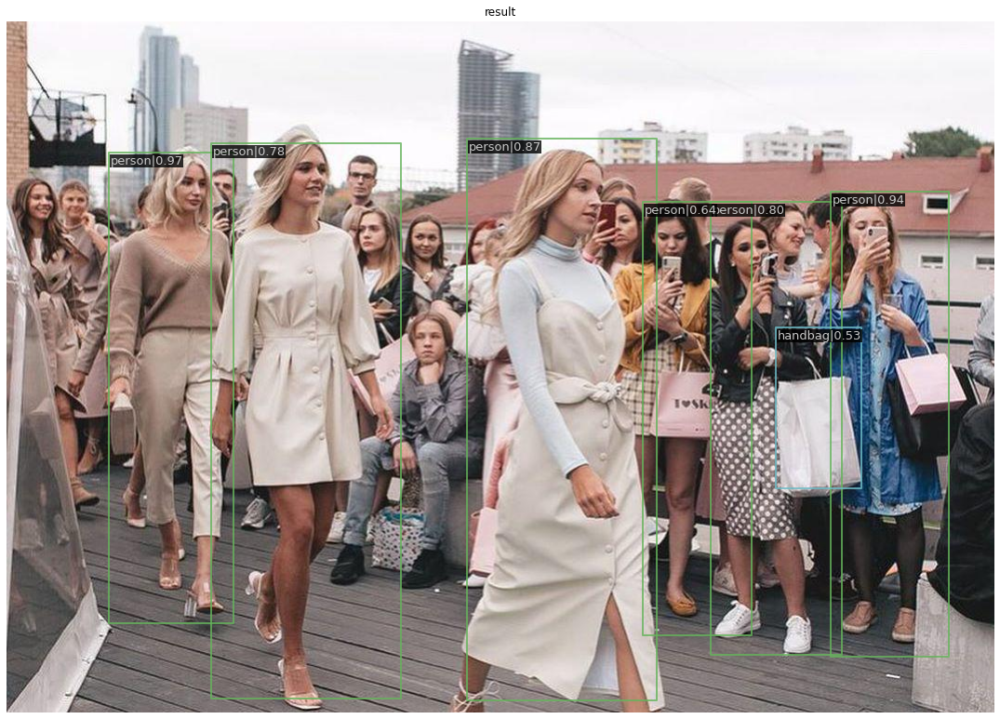

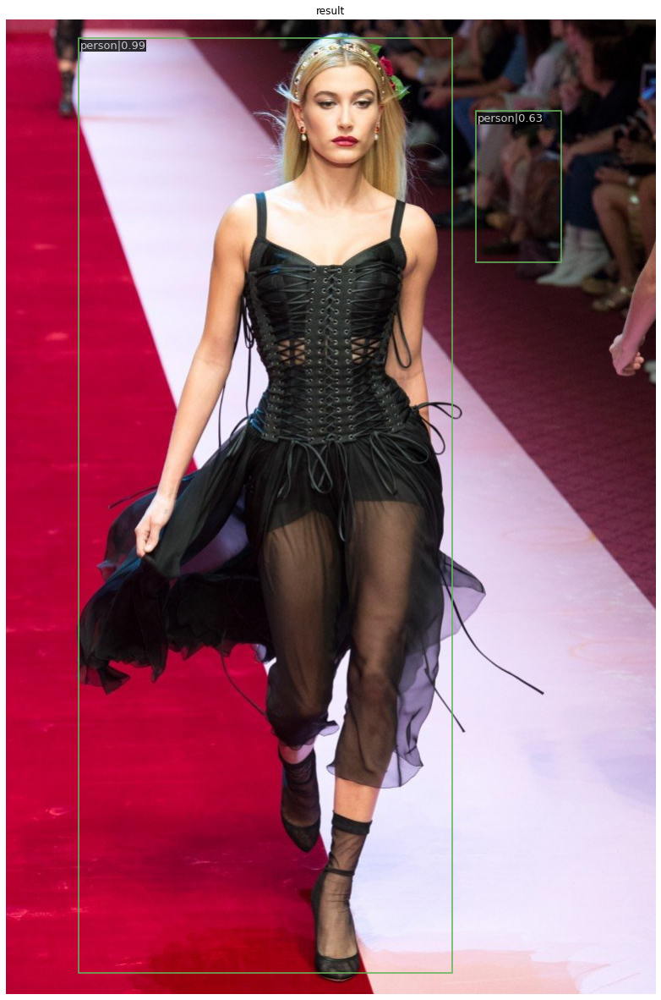

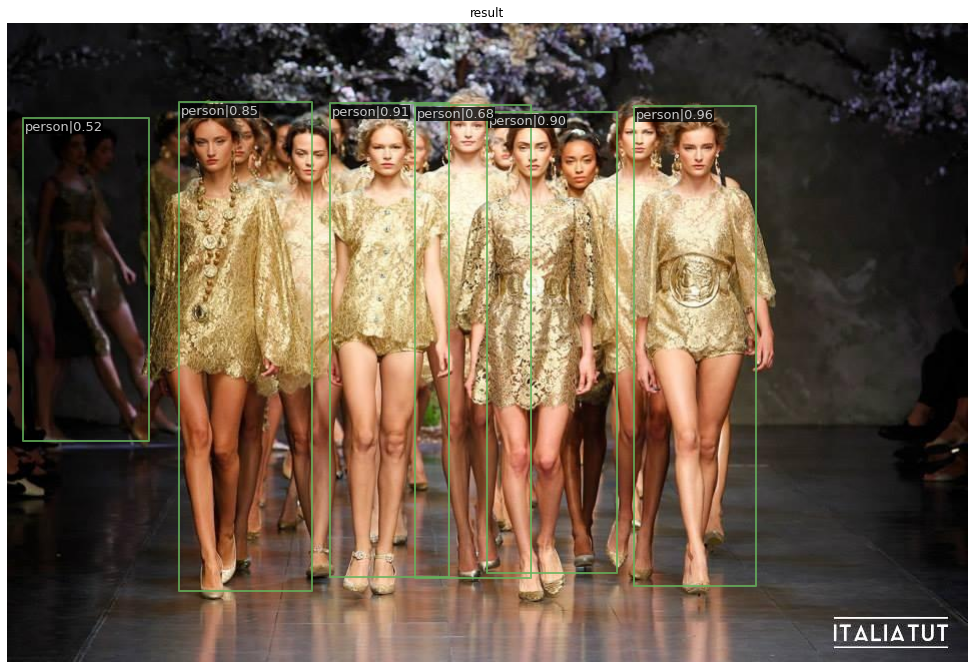

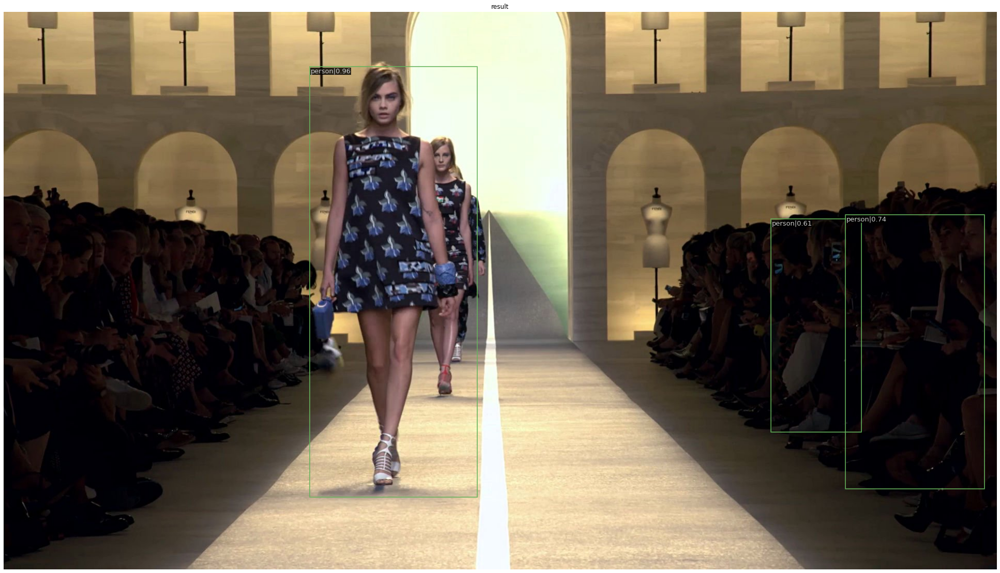

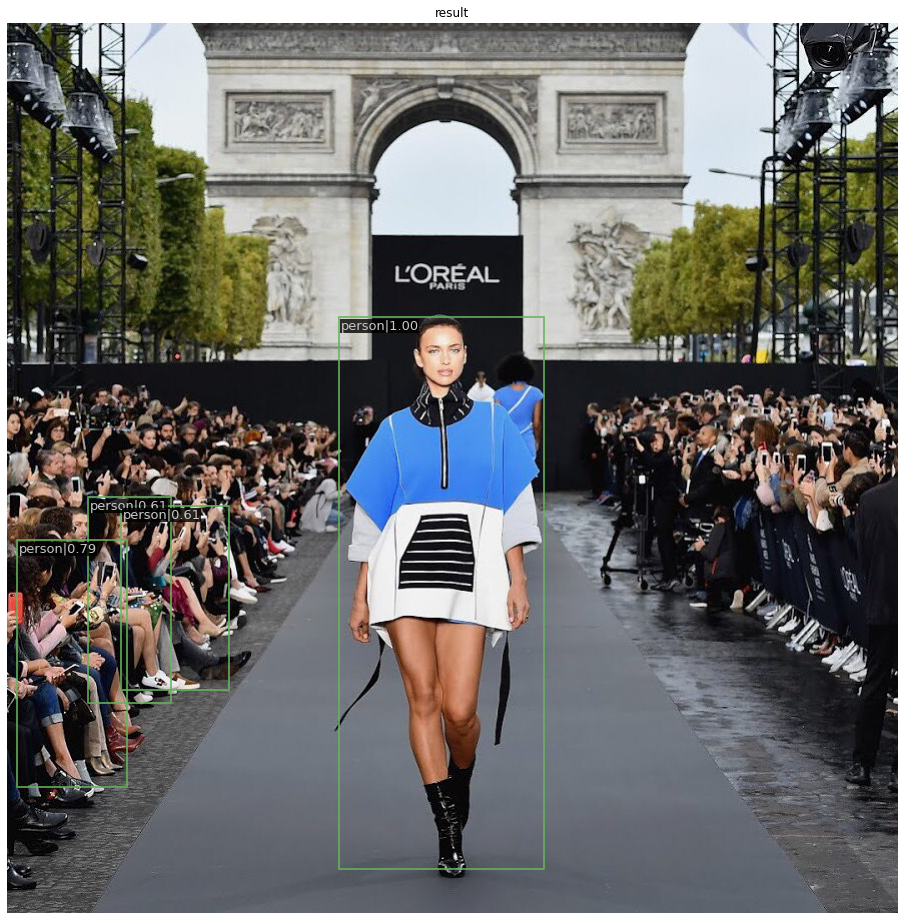

In [5]:
imgs = listdir(join(DEMO_PATH, 'demo_images'))

for img in imgs:
    result = inference_detector(model_ssd300, join(DEMO_PATH, 'demo_images', img))
    show_result_pyplot(model_ssd300, join(DEMO_PATH, 'demo_images', img), result, score_thr=0.5)

Model does not see any clothes!

In [3]:
datasets = [build_dataset(cfg.data.train)]

/home/danil/projects/fashion_detection/mmdetection/mmdet/datasets/custom.py:181: UserWarning: CustomDataset does not support filtering empty gt images.
  warnings.warn(


In [4]:
datasets[0].dataset


DeepFashion2 Train dataset with number of images 191961, and instance counts: 
+------------------------+-------+---------------------+-------+--------------------------+-------+-------------------------+-------+------------------------+-------+
| category               | count | category            | count | category                 | count | category                | count | category               | count |
+------------------------+-------+---------------------+-------+--------------------------+-------+-------------------------+-------+------------------------+-------+
| 0 [short sleeve top]   | 53193 | 1 [long sleeve top] | 24598 | 2 [short sleeve outwear] | 428   | 3 [long sleeve outwear] | 11000 | 4 [vest]               | 12699 |
| 5 [sling]              | 1604  | 6 [shorts]          | 11941 | 7 [trousers]             | 24015 | 8 [skirt]               | 7286  | 9 [short sleeve dress] | 16693 |
|                        |       |                     |       |                     

In [5]:
model = build_detector(cfg.model, train_cfg=cfg.get('train_cfg'), test_cfg=cfg.get('test_cfg'))
model.CLASSES = datasets[0].CLASSES

mmcv.mkdir_or_exist(cfg.work_dir)

## Train model

In [6]:
train_detector(model, datasets, cfg, distributed=False, validate=True)

2023-01-26 12:16:29,650 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2023-01-26 12:21:15,720 - mmdet - INFO - load checkpoint from local path: checkpoints/ssd300_coco_20210803_015428-d231a06e.pth
2023-01-26 12:21:16,968 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for bbox_head.cls_convs.0.0.weight: copying a param with shape torch.Size([324, 512, 3, 3]) from checkpoint, the shape in current model is torch.Size([56, 512, 3, 3]).
size mismatch for bbox_head.cls_convs.0.0.bias: copying a param with shape torch.Size([324]) from checkpoint, the shape in current model is torch.Size([56]).
size mismatch for bbox_head.cls_convs.1.0.weight: copying a param with shape torch.Size([486, 1024, 3, 3]) from checkpoint, the shape in current model is torch.Size([84, 1024, 3, 3]).
size mismatch for bbox_head.cls_convs.1.0.bias: copying a param with shape torch.Size([486]) from checkpoint, the shape in current model is torch.Size(

[>>>>>>>>>>>>>>>>>>>>>>>>] 32153/32153, 44.6 task/s, elapsed: 721s, ETA:     0s
---------------iou_thr: 0.5---------------


2023-01-26 22:22:58,776 - mmdet - INFO - 
+----------------------+------+-------+--------+-------+
| class                | gts  | dets  | recall | ap    |
+----------------------+------+-------+--------+-------+
| short sleeve top     | 9466 | 33042 | 0.983  | 0.816 |
| long sleeve top      | 4253 | 23943 | 0.986  | 0.586 |
| short sleeve outwear | 105  | 365   | 0.381  | 0.086 |
| long sleeve outwear  | 1662 | 11711 | 0.978  | 0.639 |
| vest                 | 1736 | 10666 | 0.941  | 0.609 |
| sling                | 270  | 3274  | 0.644  | 0.176 |
| shorts               | 1201 | 11955 | 0.946  | 0.592 |
| trousers             | 3057 | 25443 | 0.974  | 0.665 |
| skirt                | 2098 | 16832 | 0.927  | 0.517 |
| short sleeve dress   | 3023 | 16863 | 0.975  | 0.665 |
| long sleeve dress    | 1401 | 12596 | 0.956  | 0.397 |
| vest dress           | 2980 | 12704 | 0.951  | 0.734 |
| sling dress          | 717  | 9028  | 0.858  | 0.283 |
+----------------------+------+-------+-------

Ok we get normal metric. It is normal when fit 1 epoch)

# Inference model

In [5]:
model = init_detector(cfg, 'outputs/ssd300_coco/latest.pth', device=DEVICE)

load checkpoint from local path: outputs/ssd300_coco/latest.pth


## Train images

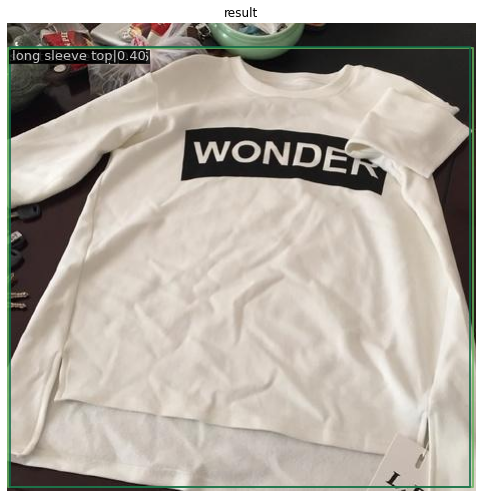

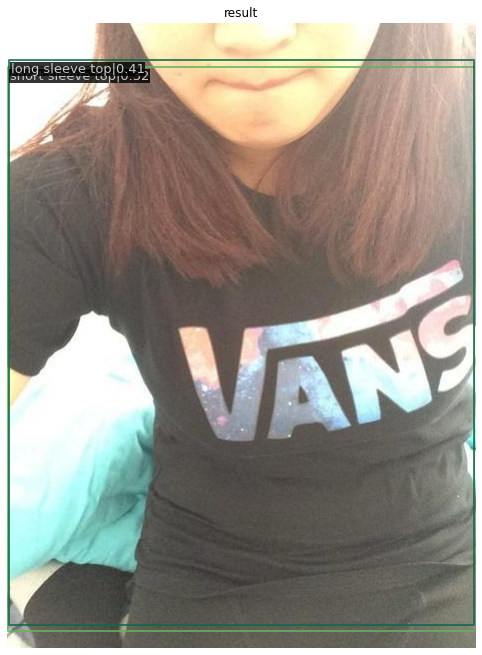

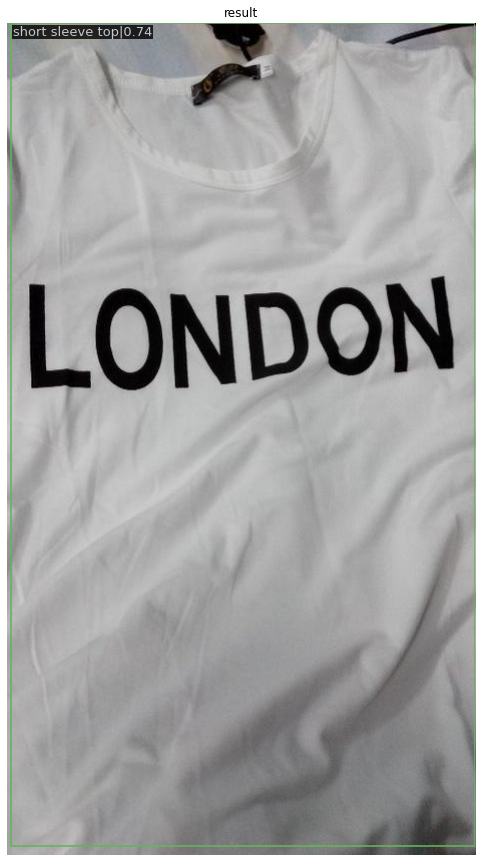

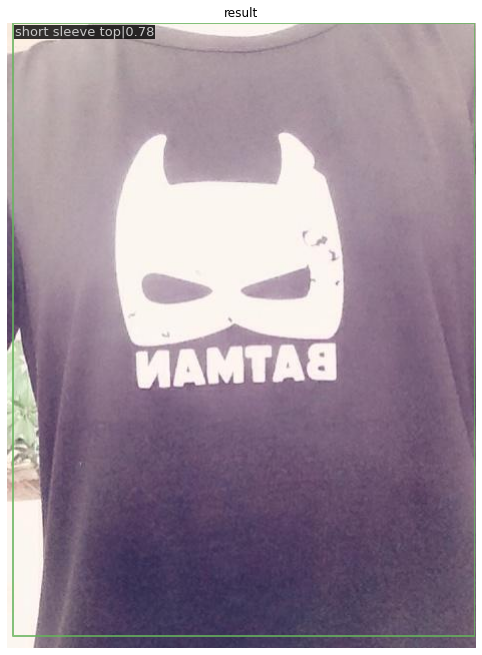

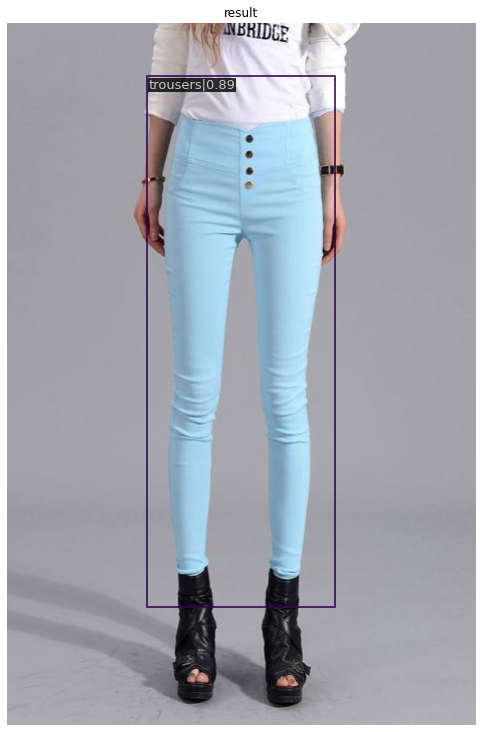

In [9]:
imgs = sample(os.listdir('data/train/image/'), 5)

for img in imgs:
    img = mmcv.imread(join('data/train/image/', img))
    result = inference_detector(model, img)
    show_result_pyplot(model, img, result, score_thr=0.3)

## Validation images

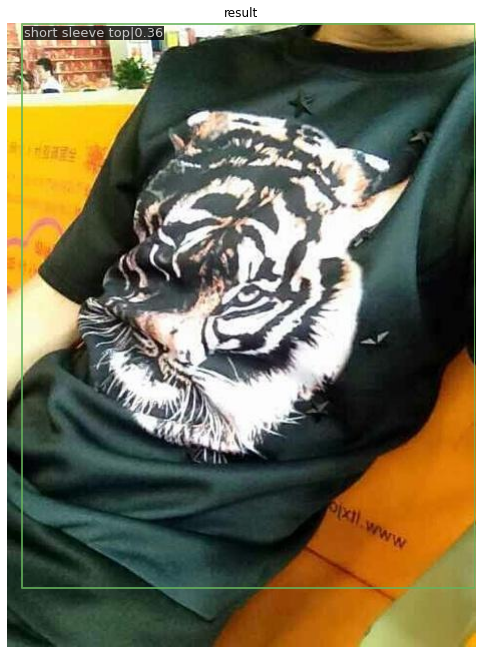

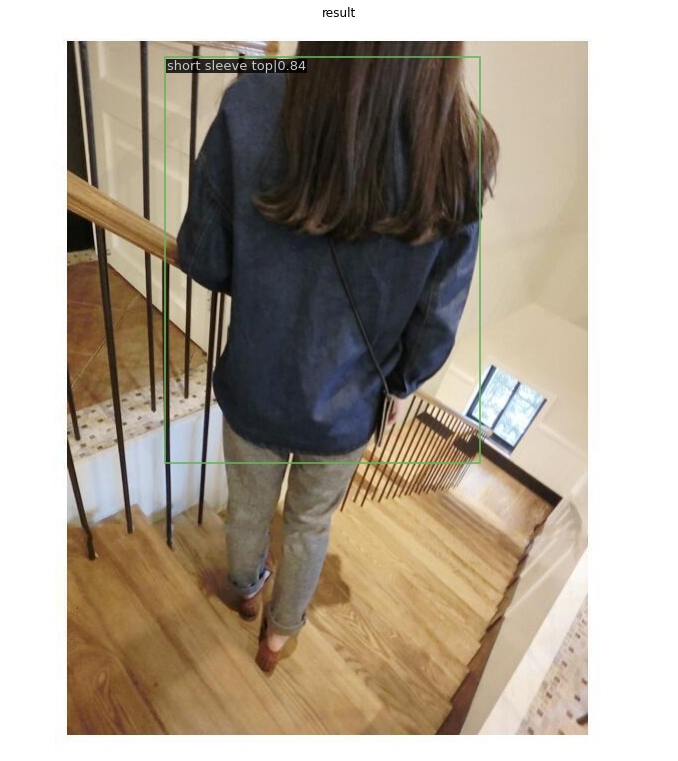

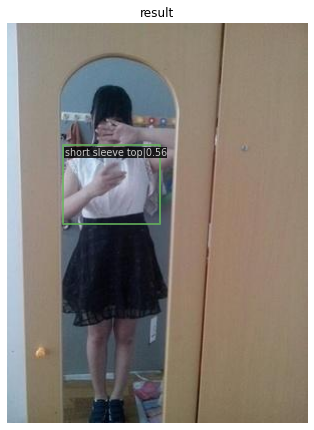

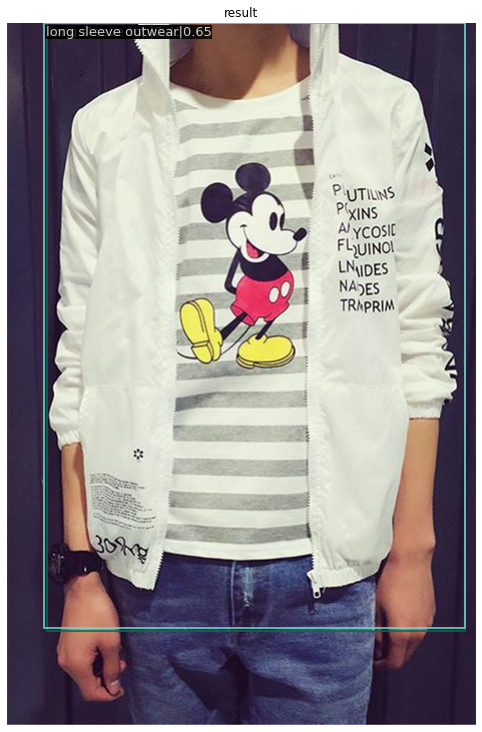

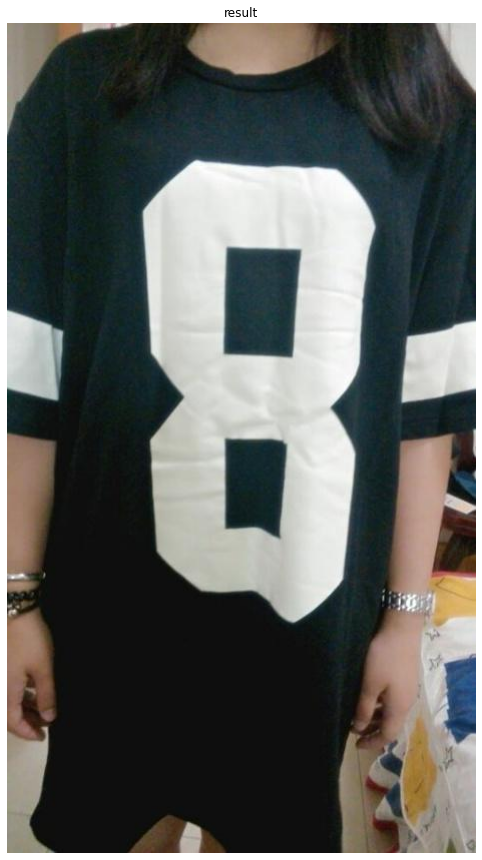

In [11]:
imgs = sample(os.listdir('data/validation/image/'), 5)

for img in imgs:
    img = mmcv.imread(join('data/validation/image/', img))
    result = inference_detector(model, img)
    show_result_pyplot(model, img, result, score_thr=0.3)

## Demo images

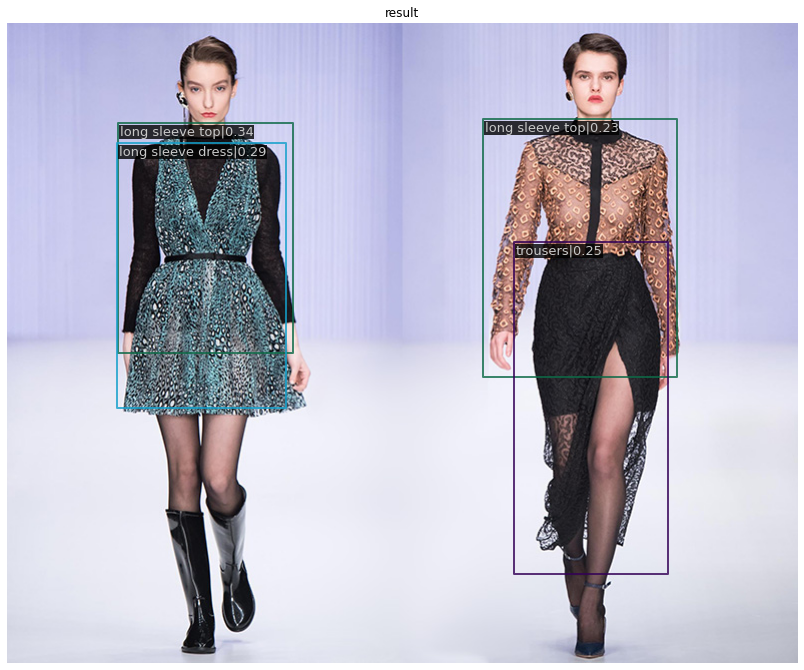

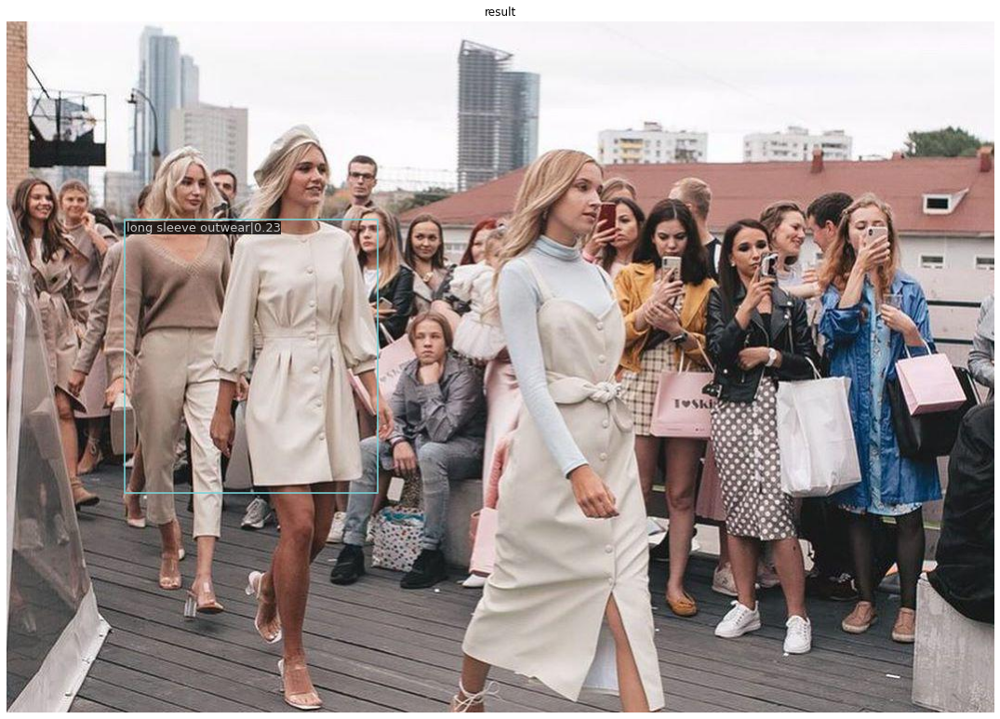

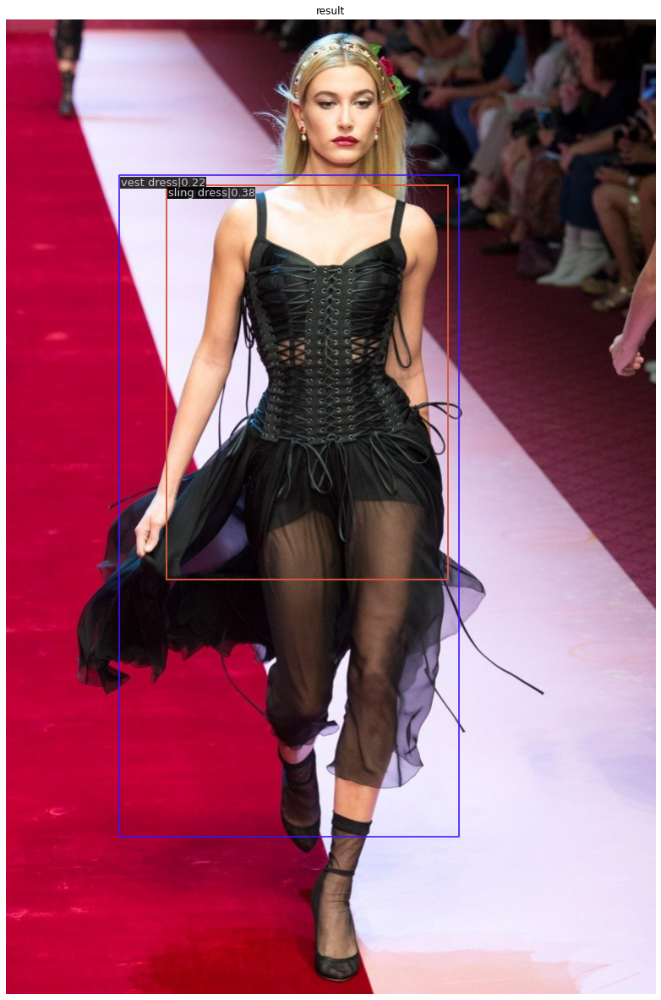

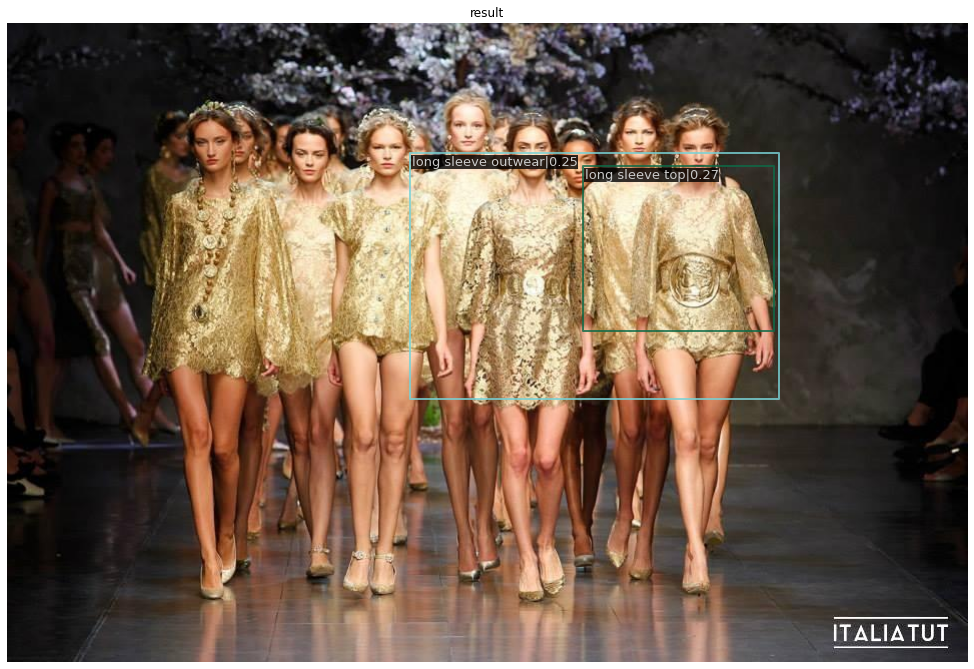

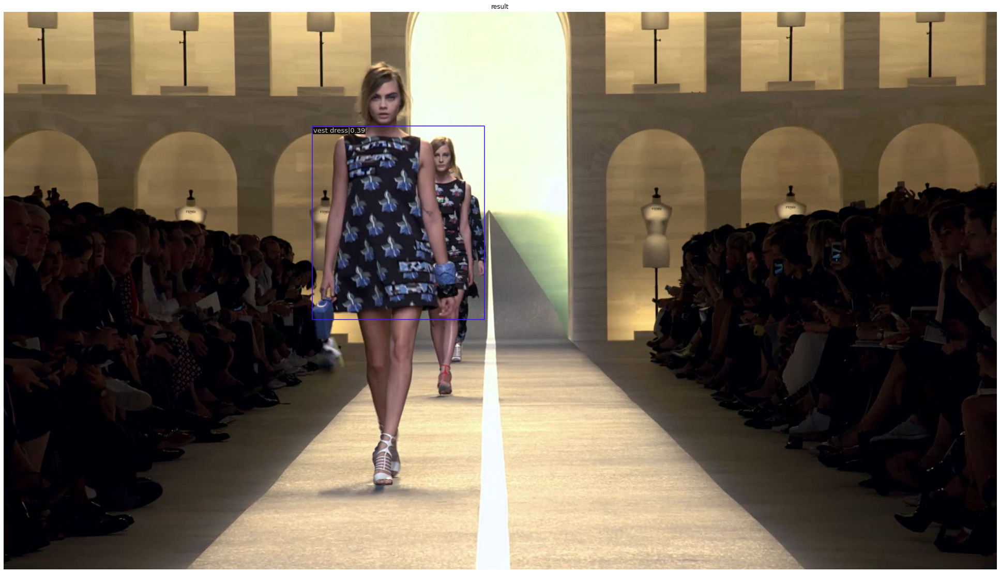

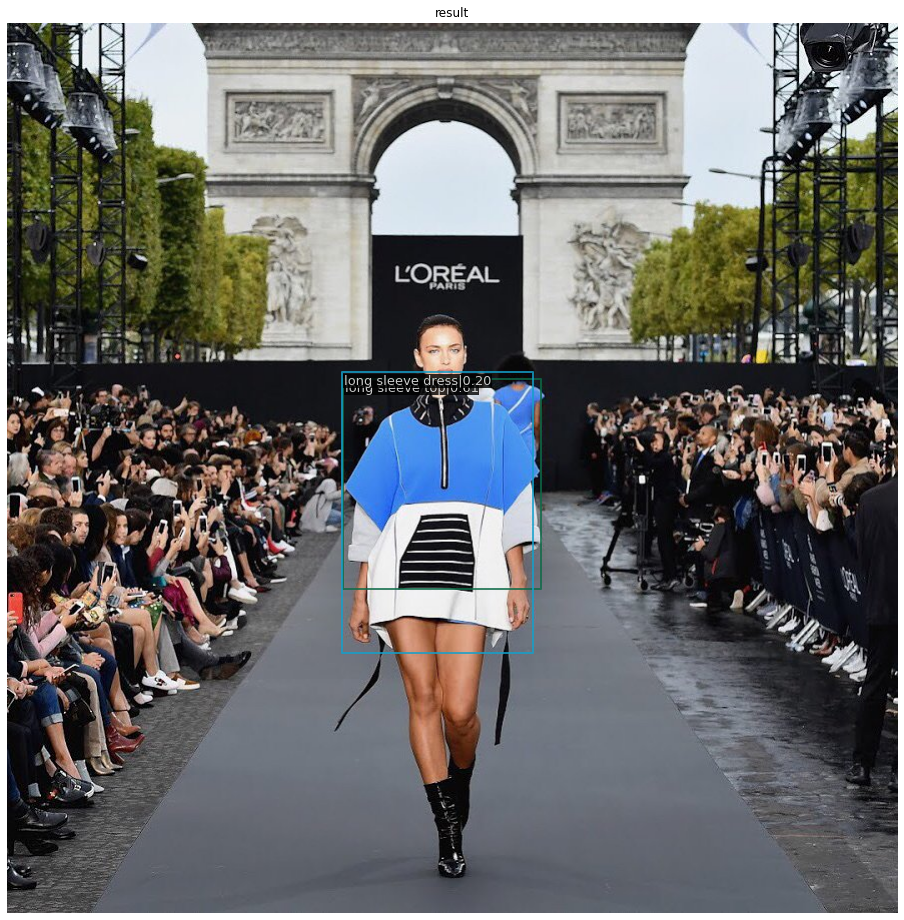

In [17]:
imgs = listdir('demo/demo_images')

for img in imgs:
    if img.split('.')[1] in ['jpg', 'jpeg', 'png']:
        img = mmcv.imread(join('demo/demo_images/', img))
        result = inference_detector(model, img)
        show_result_pyplot(model, img, result, score_thr=0.2)